## Data Exploration and Analysis

In [73]:
import sys
sys.path.insert(0,'../scripts/')

In [74]:
# Setting Notebook preference options
import pandas as pd
from sklearn.decomposition import PCA
pd.set_option('max_column', None)
pd.set_option('display.float_format', '{:.2f}'.format)
%matplotlib inline

In [75]:
from data_loader import load_df_from_csv
from data_information import DataInfo
from data_cleaner import DataCleaner
import graph_utils

#### Type Modification before Analysis

In [76]:
clean_data = load_df_from_csv("../data/teleCo_clean_data.csv")
cleaner = DataCleaner(clean_data)
cleaner.remove_unwanted_columns(cleaner.df.columns[0])
df = cleaner.change_columns_type_to(['IMSI','Handset Manufacturer','Handset Type','IMEI','MSISDN/Number','Bearer Id'],'category')

explorer = DataInfo(df)

### Variable Identification

In [77]:
explorer.get_information()

DataFrame Information: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 60 columns):
 #   Column                               Non-Null Count   Dtype   
---  ------                               --------------   -----   
 0   Bearer Id                            150000 non-null  category
 1   Start                                150000 non-null  object  
 2   Start sec                            150000 non-null  float32 
 3   End                                  150000 non-null  object  
 4   End sec                              150000 non-null  float32 
 5   Dur. (hr)                            150000 non-null  float32 
 6   IMSI                                 150000 non-null  category
 7   MSISDN/Number                        150000 non-null  category
 8   IMEI                                 150000 non-null  category
 9   Last Location Name                   148848 non-null  object  
 10  Avg RTT DL (ms)                      150000 

Type of Variables
We can have a lot of predicator-target correlation for different purposes, but for the time-being lets assume we want our target to be the total duration time of the use
- Predicator Variables
    - start_date
    - start_time
    - MSISDN/Number
    - Total Data (MegaBytes)
    - Total Social Media Data (MegaBytes)
    - Total Google Data (MegaBytes)
    - Total Email Data (MegaBytes)
    - Total Youtube Data (MegaBytes)
    - Total Netflix Data (MegaBytes)
    - Total Gaming Data (MegaBytes)
    - Total Other Data (MegaBytes)
    - Jitter (ms)
    - Avg Delay (ms)
    - Avg Throughput (kbps)
    - Last Location Name
- Target Variables
    - end_date
    - end_time
    - Total Duration (hr)

Data Types
- Character

In [78]:
explorer.df.describe(include='object').columns.to_list()

['Start',
 'End',
 'Last Location Name',
 'start_date',
 'start_time',
 'end_date',
 'end_time']

- Numeric

In [79]:
explorer.df.describe(include=['float32','float64']).columns.to_list()

['Start sec',
 'End sec',
 'Dur. (hr)',
 'Avg RTT DL (ms)',
 'Avg RTT UL (ms)',
 'Avg Bearer TP DL (kbps)',
 'Avg Bearer TP UL (kbps)',
 'DL TP < 50 Kbps (%)',
 '50 Kbps < DL TP < 250 Kbps (%)',
 '250 Kbps < DL TP < 1 Mbps (%)',
 'DL TP > 1 Mbps (%)',
 'UL TP < 10 Kbps (%)',
 '10 Kbps < UL TP < 50 Kbps (%)',
 '50 Kbps < UL TP < 300 Kbps (%)',
 'UL TP > 300 Kbps (%)',
 'Activity Duration DL (sec)',
 'Activity Duration UL (sec)',
 'Total Duration (hr)',
 'Nb of sec with Vol DL < 6250B',
 'Nb of sec with Vol UL < 1250B',
 'Social Media DL (MegaBytes)',
 'Social Media UL (MegaBytes)',
 'Google DL (MegaBytes)',
 'Google UL (MegaBytes)',
 'Email DL (MegaBytes)',
 'Email UL (MegaBytes)',
 'Youtube DL (MegaBytes)',
 'Youtube UL (MegaBytes)',
 'Netflix DL (MegaBytes)',
 'Netflix UL (MegaBytes)',
 'Gaming DL (MegaBytes)',
 'Gaming UL (MegaBytes)',
 'Other DL (MegaBytes)',
 'Other UL (MegaBytes)',
 'Total UL (MegaBytes)',
 'Total DL (MegaBytes)',
 'Total Data (MegaBytes)',
 'Total Social Media Da

Variable Category
- Categorical

In [80]:
explorer.df.describe(include='category').columns.to_list()

['Bearer Id',
 'IMSI',
 'MSISDN/Number',
 'IMEI',
 'Handset Manufacturer',
 'Handset Type']

- Continous
    The remaining columns apart from the categorical variables are all continous

### Data Understanding (Basic Matrics Analysis)

In [81]:
explorer.get_description()

,Start sec,End sec,Dur. (hr),Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),Activity Duration DL (sec),Activity Duration UL (sec),Total Duration (hr),Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (MegaBytes),Social Media UL (MegaBytes),Google DL (MegaBytes),Google UL (MegaBytes),Email DL (MegaBytes),Email UL (MegaBytes),Youtube DL (MegaBytes),Youtube UL (MegaBytes),Netflix DL (MegaBytes),Netflix UL (MegaBytes),Gaming DL (MegaBytes),Gaming UL (MegaBytes),Other DL (MegaBytes),Other UL (MegaBytes),Total UL (MegaBytes),Total DL (MegaBytes),Total Data (MegaBytes),Total Social Media Data (MegaBytes),Total Google Data (MegaBytes),Total Email Data (MegaBytes),Total Youtube Data (MegaBytes),Total Netflix Data (MegaBytes),Total Gaming Data (MegaBytes),Total Other Data (MegaBytes),Jitter (ms),Avg Delay (ms),Avg Throughput (kbps)
count,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00
mean,0.50,0.50,0.03,97.77,15.32,13300.05,1770.43,92.84,3.07,1.72,1.60,98.54,0.77,0.15,0.08,1829.18,1408.88,29.06,3702.11,4001.99,1.80,0.03,5.75,2.06,1.79,0.47,11.63,11.01,11.63,11.00,422.04,8.29,421.10,8.26,41.12,454.64,495.76,1.83,7.81,2.26,22.64,22.63,430.33,429.37,-420296.91,-82.46,-11529.62
std,0.29,0.29,0.02,559.91,76.69,23971.88,4625.36,13.01,6.20,4.15,4.82,4.62,3.22,1.62,1.29,5696.40,4643.23,22.51,9151.91,10137.22,1.04,0.02,3.31,1.19,1.04,0.27,6.71,6.35,6.73,6.36,243.97,4.78,243.21,4.77,11.28,244.14,244.38,1.04,3.52,1.07,9.25,9.26,244.02,243.27,2482590.25,564.34,21736.23
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.98,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2.87,7.11,28.96,0.00,0.04,0.01,0.08,0.10,0.31,0.15,-84124624.00,-96922.00,-374058.00
25%,0.25,0.25,0.02,35.00,3.00,43.00,47.00,91.00,0.00,0.00,0.00,99.00,0.00,0.00,0.00,14.88,21.54,15.96,88.00,107.00,0.90,0.02,2.88,1.02,0.89,0.23,5.83,5.52,5.78,5.48,210.47,4.13,210.18,4.15,33.22,243.11,284.48,0.93,4.94,1.36,16.00,15.98,218.73,218.55,-24888.25,-49.00,-16193.25
50%,0.50,0.50,0.02,45.00,5.00,63.00,63.00,100.00,0.00,0.00,0.00,100.00,0.00,0.00,0.00,39.30,46.79,24.00,203.00,217.00,1.79,0.03,5.77,2.05,1.79,0.47,11.62,11.01,11.64,11.00,423.41,8.29,421.81,8.27,41.14,455.84,496.86,1.83,7.81,2.26,22.66,22.64,431.62,429.99,486.00,-40.00,-9.00
75%,0.75,0.75,0.04,62.00,11.00,19710.75,1120.00,100.00,4.00,1.00,0.00,100.00,0.00,0.00,0.00,679.61,599.10,36.79,2608.00,2417.00,2.69,0.05,8.62,3.09,2.69,0.70,17.45,16.52,17.47,16.51,633.17,12.43,631.70,12.38,49.03,665.71,706.51,2.73,10.68,3.16,29.29,29.29,641.42,639.93,5931.00,-27.00,7.00
max,1.00,1.00,0.52,96923.00,7120.00,378160.00,58613.00,100.00,93.00,100.00,94.00,100.00,98.00,100.00,96.00,136536.47,144911.30,516.48,604061.00,604122.00,3.59,0.07,11.46,4.12,3.59,0.94,23.26,22.01,23.26,22.01,843.44,16.56,843.44,16.56,78.33,902.97,955.98,3.65,15.53,4.52,45.19,45.20,859.20,859.52,144712880.00,7082.00,39950.00


In [82]:
explorer.get_dispersion_params()

,Start sec,End sec,Dur. (hr),Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),Activity Duration DL (sec),Activity Duration UL (sec),Total Duration (hr),Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (MegaBytes),Social Media UL (MegaBytes),Google DL (MegaBytes),Google UL (MegaBytes),Email DL (MegaBytes),Email UL (MegaBytes),Youtube DL (MegaBytes),Youtube UL (MegaBytes),Netflix DL (MegaBytes),Netflix UL (MegaBytes),Gaming DL (MegaBytes),Gaming UL (MegaBytes),Other DL (MegaBytes),Other UL (MegaBytes),Total UL (MegaBytes),Total DL (MegaBytes),Total Data (MegaBytes),Total Social Media Data (MegaBytes),Total Google Data (MegaBytes),Total Email Data (MegaBytes),Total Youtube Data (MegaBytes),Total Netflix Data (MegaBytes),Total Gaming Data (MegaBytes),Total Other Data (MegaBytes),Jitter (ms),Avg Delay (ms),Avg Throughput (kbps)
count,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00,150000.00
mean,0.50,0.50,0.03,97.77,15.32,13300.05,1770.43,92.84,3.07,1.72,1.60,98.54,0.77,0.15,0.08,1829.18,1408.88,29.06,3702.11,4001.99,1.80,0.03,5.75,2.06,1.79,0.47,11.63,11.01,11.63,11.00,422.04,8.29,421.10,8.26,41.12,454.64,495.76,1.83,7.81,2.26,22.64,22.63,430.33,429.37,-420296.91,-82.46,-11529.62
std,0.29,0.29,0.02,559.91,76.69,23971.88,4625.36,13.01,6.20,4.15,4.82,4.62,3.22,1.62,1.29,5696.40,4643.23,22.51,9151.91,10137.22,1.04,0.02,3.31,1.19,1.04,0.27,6.71,6.35,6.73,6.36,243.97,4.78,243.21,4.77,11.28,244.14,244.38,1.04,3.52,1.07,9.25,9.26,244.02,243.27,2482590.25,564.34,21736.23
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.98,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2.87,7.11,28.96,0.00,0.04,0.01,0.08,0.10,0.31,0.15,-84124624.00,-96922.00,-374058.00
25%,0.25,0.25,0.02,35.00,3.00,43.00,47.00,91.00,0.00,0.00,0.00,99.00,0.00,0.00,0.00,14.88,21.54,15.96,88.00,107.00,0.90,0.02,2.88,1.02,0.89,0.23,5.83,5.52,5.78,5.48,210.47,4.13,210.18,4.15,33.22,243.11,284.48,0.93,4.94,1.36,16.00,15.98,218.73,218.55,-24888.25,-49.00,-16193.25
50%,0.50,0.50,0.02,45.00,5.00,63.00,63.00,100.00,0.00,0.00,0.00,100.00,0.00,0.00,0.00,39.30,46.79,24.00,203.00,217.00,1.79,0.03,5.77,2.05,1.79,0.47,11.62,11.01,11.64,11.00,423.41,8.29,421.81,8.27,41.14,455.84,496.86,1.83,7.81,2.26,22.66,22.64,431.62,429.99,486.00,-40.00,-9.00
75%,0.75,0.75,0.04,62.00,11.00,19710.75,1120.00,100.00,4.00,1.00,0.00,100.00,0.00,0.00,0.00,679.61,599.10,36.79,2608.00,2417.00,2.69,0.05,8.62,3.09,2.69,0.70,17.45,16.52,17.47,16.51,633.17,12.43,631.70,12.38,49.03,665.71,706.51,2.73,10.68,3.16,29.29,29.29,641.42,639.93,5931.00,-27.00,7.00
max,1.00,1.00,0.52,96923.00,7120.00,378160.00,58613.00,100.00,93.00,100.00,94.00,100.00,98.00,100.00,96.00,136536.47,144911.30,516.48,604061.00,604122.00,3.59,0.07,11.46,4.12,3.59,0.94,23.26,22.01,23.26,22.01,843.44,16.56,843.44,16.56,78.33,902.97,955.98,3.65,15.53,4.52,45.19,45.20,859.20,859.52,144712880.00,7082.00,39950.00
Mode,0.34,0.87,0.02,45.00,5.00,23.00,40.00,100.00,0.00,0.00,0.00,100.00,0.00,0.00,0.00,0.00,0.00,24.00,3.00,217.00,0.15,0.03,3.99,3.43,1.83,0.05,18.87,3.40,2.10,1.75,453.16,15.30,357.81,4.51,35.58,74.13,833.15,0.15,5.24,0.65,22.67,3.19,15.15,50.57,0.00,-40.00,3.00
Median,0.50,0.50,0.02,45.00,5.00,63.00,63.00,100.00,0.00,0.00,0.00,100.00,0.00,0.00,0.00,39.30,46.79,24.00,203.00,217.00,1.79,0.03,5.77,2.05,1.79,0.4

- These dispersion parameters describe
    - The middle value of the column in the form of mean or median(more middle value than mean if the column is skewed)
    - The minimum and maximum value of each column
    - The most occuring value in the column
    - Where the values of the column lie depending on the percentile (like 25% of the data is equal or below that specified value)
    - The difference among the three important dispersion values (mean, median, and mode)

- Based on the dispersion parameters results, it helps us to
    - know the skewness or distribution
    - know if our data needs to be transformed (scaling and normalization )
    - know the where most of our data is around (like below 75% or 80% of the entire column)
    - know the population distribution type by infering to the relationship among mean, mode and median values (if mode > median > mean implies a negative skewness and so on ...)
    - know where outliers exist

In [83]:
# explorer.df.describe(include='category')

,Bearer Id,IMSI,MSISDN/Number,IMEI,Handset Manufacturer,Handset Type
count,150000,150000.00,150000.00,150000.00,140442,140442
unique,134709,43.00,35090.00,4583.00,169,1395
top,,208201710567424.00,33663707136.00,86376900984832.00,Apple,Huawei B528S-23A
freq,990,28881.00,1082.00,19752.00,59565,19752


Describe this

### Data Exploration

#### Non-Graphical Uni-variate Analysis (for every quantitative data)

In [84]:
# explorer.df.select_dtypes(include='number').columns.to_list()

['Start sec',
 'End sec',
 'Dur. (hr)',
 'Avg RTT DL (ms)',
 'Avg RTT UL (ms)',
 'Avg Bearer TP DL (kbps)',
 'Avg Bearer TP UL (kbps)',
 'DL TP < 50 Kbps (%)',
 '50 Kbps < DL TP < 250 Kbps (%)',
 '250 Kbps < DL TP < 1 Mbps (%)',
 'DL TP > 1 Mbps (%)',
 'UL TP < 10 Kbps (%)',
 '10 Kbps < UL TP < 50 Kbps (%)',
 '50 Kbps < UL TP < 300 Kbps (%)',
 'UL TP > 300 Kbps (%)',
 'Activity Duration DL (sec)',
 'Activity Duration UL (sec)',
 'Total Duration (hr)',
 'Nb of sec with Vol DL < 6250B',
 'Nb of sec with Vol UL < 1250B',
 'Social Media DL (MegaBytes)',
 'Social Media UL (MegaBytes)',
 'Google DL (MegaBytes)',
 'Google UL (MegaBytes)',
 'Email DL (MegaBytes)',
 'Email UL (MegaBytes)',
 'Youtube DL (MegaBytes)',
 'Youtube UL (MegaBytes)',
 'Netflix DL (MegaBytes)',
 'Netflix UL (MegaBytes)',
 'Gaming DL (MegaBytes)',
 'Gaming UL (MegaBytes)',
 'Other DL (MegaBytes)',
 'Other UL (MegaBytes)',
 'Total UL (MegaBytes)',
 'Total DL (MegaBytes)',
 'Total Data (MegaBytes)',
 'Total Social Media Da

In [85]:
explorer.get_column_description('Bearer Id')

count     150000
unique    134709
top             
freq         990
Name: Bearer Id, dtype: object

In [86]:
explorer.get_column_dispersion_params('Total Duration (hr)')

count    150000.00
mean         29.06
std          22.51
min           1.98
25%          15.96
50%          24.00
75%          36.79
max         516.48
Mode         24.00
Median       24.00
Name: Total Duration (hr), dtype: float64

- Total Duration (hr) :
The mean value and the mode value are different by a small margin indicating that the column is positively skeewed but mode and median are equal indicating that most values are located in the middle. Large outlier values exist as the max value and the rest of the percentiles vary greatly.

In [87]:
explorer.get_column_dispersion_params('Total UL (MegaBytes)')

count    150000.00
mean         41.12
std          11.28
min           2.87
25%          33.22
50%          41.14
75%          49.03
max          78.33
Mode         35.58
Median       41.14
Name: Total UL (MegaBytes), dtype: float64

- Total UL (MegaBytes) :
The mean and median are almost equal but mode is smaller indicating a positive skeewness. Outliers seems to exist a bit due to inbalance from between percentiles and max-min values.

In [88]:
explorer.get_column_dispersion_params('Total DL (MegaBytes)')

count    150000.00
mean        454.64
std         244.14
min           7.11
25%         243.11
50%         455.84
75%         665.71
max         902.97
Mode         74.13
Median      455.84
Name: Total DL (MegaBytes), dtype: float64

- Total DL (MegaBytes) :
The mean and median are almost equal but mode is very small indicating a huge positive skeewness. Outliers seems to exist a bit due to inbalance from between percentiles and max-min values.

In [89]:
explorer.get_column_dispersion_params('Total Data (MegaBytes)')

count    150000.00
mean        495.76
std         244.38
min          28.96
25%         284.48
50%         496.86
75%         706.51
max         955.98
Mode        833.15
Median      496.86
Name: Total Data (MegaBytes), dtype: float64

- Total Data (MegaBytes) :
The mean and median are almost equal but mode is very small indicating a huge positive skeewness. Outliers seems to exist a bit due to inbalance from between percentiles and max-min values.

In [90]:
explorer.get_column_dispersion_params('Total Social Media Data (MegaBytes)')

count    150000.00
mean          1.83
std           1.04
min           0.00
25%           0.93
50%           1.83
75%           2.73
max           3.65
Mode          0.15
Median        1.83
Name: Total Social Media Data (MegaBytes), dtype: float64

In [91]:
explorer.get_column_dispersion_params('Total Google Data (MegaBytes)')

count    150000.00
mean          7.81
std           3.52
min           0.04
25%           4.94
50%           7.81
75%          10.68
max          15.53
Mode          5.24
Median        7.81
Name: Total Google Data (MegaBytes), dtype: float64

In [92]:
explorer.get_column_dispersion_params('Total Email Data (MegaBytes)')

count    150000.00
mean          2.26
std           1.07
min           0.01
25%           1.36
50%           2.26
75%           3.16
max           4.52
Mode          0.65
Median        2.26
Name: Total Email Data (MegaBytes), dtype: float64

In [93]:
explorer.get_column_dispersion_params('Total Youtube Data (MegaBytes)')

count    150000.00
mean         22.64
std           9.25
min           0.08
25%          16.00
50%          22.66
75%          29.29
max          45.19
Mode         22.67
Median       22.66
Name: Total Youtube Data (MegaBytes), dtype: float64

In [94]:
explorer.get_column_dispersion_params('Total Netflix Data (MegaBytes)')

count    150000.00
mean         22.63
std           9.26
min           0.10
25%          15.98
50%          22.64
75%          29.29
max          45.20
Mode          3.19
Median       22.64
Name: Total Netflix Data (MegaBytes), dtype: float64

In [95]:
explorer.get_column_dispersion_params('Total Gaming Data (MegaBytes)')

count    150000.00
mean        430.33
std         244.02
min           0.31
25%         218.73
50%         431.62
75%         641.42
max         859.20
Mode         15.15
Median      431.62
Name: Total Gaming Data (MegaBytes), dtype: float64

In [96]:
explorer.get_column_dispersion_params('Total Other Data (MegaBytes)')

count    150000.00
mean        429.37
std         243.27
min           0.15
25%         218.55
50%         429.99
75%         639.93
max         859.52
Mode         50.57
Median      429.99
Name: Total Other Data (MegaBytes), dtype: float64

In [16]:
#explorer.get_column_dispersion_params('Start sec')

- Start sec :
The mean and median are equal but the mode(most frequent value is a bit less), distribution is a little bit skeewed to the positive side. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [17]:
#explorer.get_column_dispersion_params('End sec')

- End sec: The mean and median are equal but the mode(most frequent value is a bit more), distribution is a little bit skeewed to the negative side. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [18]:
#explorer.get_column_dispersion_params('Avg RTT DL (ms)')

- Avg RTT DL (ms) :
The mean value and the mode value are different by a big margin indicating that the column is positively skeewed but mode and median are equal implying that the most values are in the middle .Huge outlier values exist as the max value and the rest of the percentiles vary greatly.

In [19]:
#explorer.get_column_dispersion_params('Avg RTT UL (ms)')

- Avg RTT UL (ms) :
The mean value and the mode value are different by a small margin indicating that the column is positively skeewed but mode and median are equal implying that the most values are in the middle .Huge outlier values exist as the max value and the rest of the percentiles vary greatly.

In [20]:
#explorer.get_column_dispersion_params('Avg Bearer TP DL (kbps)')

- Avg Bearer TP DL (kbps) :
The mean value and the mode value are different by a massive margin indicating that the column is positively skeewed and also mode and median are also different indicating that most values are not found near the mid-point.Huge outlier values exist as the max value and the rest of the percentiles vary greatly.

In [21]:
#explorer.get_column_dispersion_params('Avg Bearer TP UL (kbps)')

- Avg Bearer TP UL (kbps) :
The mean value and the mode value are different by a massive margin indicating that the column is positively skeewed and also mode and median are also different indicating that most values are not found near the mid-point.Huge outlier values exist as the max value and the rest of the percentiles vary greatly.

In [22]:
#explorer.get_column_dispersion_params('Activity Duration DL (sec)')

- Activity Duration DL (sec) :
The mean value and the mode value are different by a massive margin indicating that the column is positively skeewed and also mode and median are also different indicating that most values are not found near the mid-point.Huge outlier values exist as the max value and the rest of the percentiles vary greatly.

In [23]:
#explorer.get_column_dispersion_params('Activity Duration UL (sec)')

- Activity Duration UL (sec) :
The mean value and the mode value are different by a massive margin indicating that the column is positively skeewed and also mode and median are also different indicating that most values are not found near the mid-point.Huge outlier values exist as the max value and the rest of the percentiles vary greatly.

In [24]:
#explorer.get_column_dispersion_params('Social Media DL (MegaBytes)')

- Social Media DL (MegaBytes) :
The mean and median value are almost equal but the mode seems to be smaller indicating a negative skeewness. And most values arenot located in the middle as mode is different from median. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [25]:
#explorer.get_column_dispersion_params('Social Media UL (MegaBytes)')

- Social Media UL (MegaBytes) :
The mean, median and mode are equal indicating this is a bell-distribution. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [26]:
#explorer.get_column_dispersion_params('Google DL (MegaBytes)')

- Google DL (MegaBytes) :
The mean and median are almost equal but mode is smaller indicating a positive skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [27]:
#explorer.get_column_dispersion_params('Google UL (MegaBytes)')

- Google UL (MegaBytes) :
The mean and median are almost equal but mode is bigger indicating a negative skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [28]:
#explorer.get_column_dispersion_params('Email DL (MegaBytes)')

- Email DL (MegaBytes) :
The mean and median are equal but mode is a bit bigger indicating a slight negative skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [29]:
#explorer.get_column_dispersion_params('Email UL (MegaBytes)')

- Email DL (MegaBytes) :
The mean and median are equal but mode is a smaller indicating a positive skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [30]:
#explorer.get_column_dispersion_params('Youtube DL (MegaBytes)')

- Youtube DL (MegaBytes) :
The mean and median are almost equal but mode is a larger indicating a negative skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [31]:
#explorer.get_column_dispersion_params('Youtube UL (MegaBytes)')

- Youtube UL (MegaBytes) :
The mean and median are equal but mode is smaller indicating a positive skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [32]:
#explorer.get_column_dispersion_params('Netflix DL (MegaBytes)')

- Netflix DL (MegaBytes) :
The mean and median are almost equal but mode is smaller indicating a positive skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [33]:
#explorer.get_column_dispersion_params('Netflix UL (MegaBytes)')

- Netflix UL (MegaBytes) :
The mean and median are equal but mode is smaller indicating a positive skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [34]:
#explorer.get_column_dispersion_params('Gaming DL (MegaBytes)')

- Gaming DL (MegaBytes) :
The mean and median are almost equal but mode is a bit larger indicating a negative skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [35]:
#explorer.get_column_dispersion_params('Gaming UL (MegaBytes)')

- Gaming UL (MegaBytes) :
The mean and median are equal but mode is bigger indicating a negative skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [36]:
#explorer.get_column_dispersion_params('Other DL (MegaBytes)')

- Other DL (MegaBytes) :
The mean and median are equal but mode is smaller indicating a positive skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

In [37]:
#explorer.get_column_dispersion_params('Other UL (MegaBytes)')

- Other UL (MegaBytes) :
The mean and median are almost equal but mode is smaller indicating a positive skeewness. Outliers dont seems to exist as the the percentiles and min-max values are equally balanced.

#### Graphical Uni-variate Analysis

##### Distribution Diagrams

In [97]:
draw_df = explorer.df

In [101]:
# graph_utils.plot_count(draw_df,'Bearer Id')

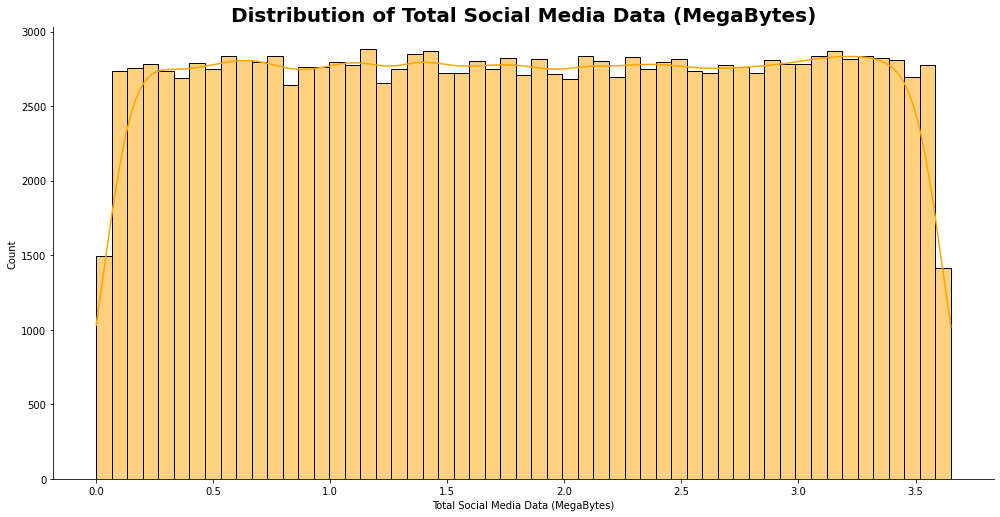

In [102]:
graph_utils.plot_hist(draw_df, 'Total Social Media Data (MegaBytes)', 'orange')

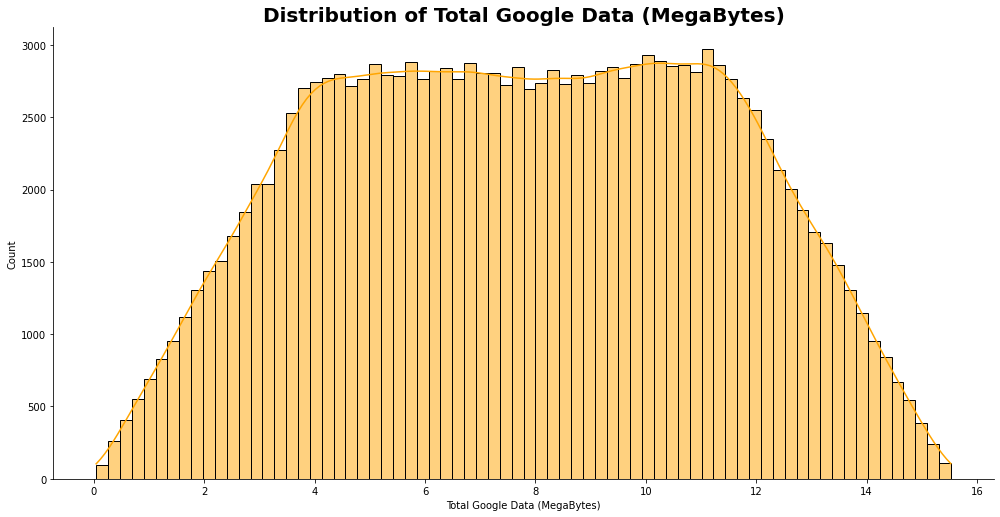

In [103]:
graph_utils.plot_hist(draw_df, 'Total Google Data (MegaBytes)', 'orange')

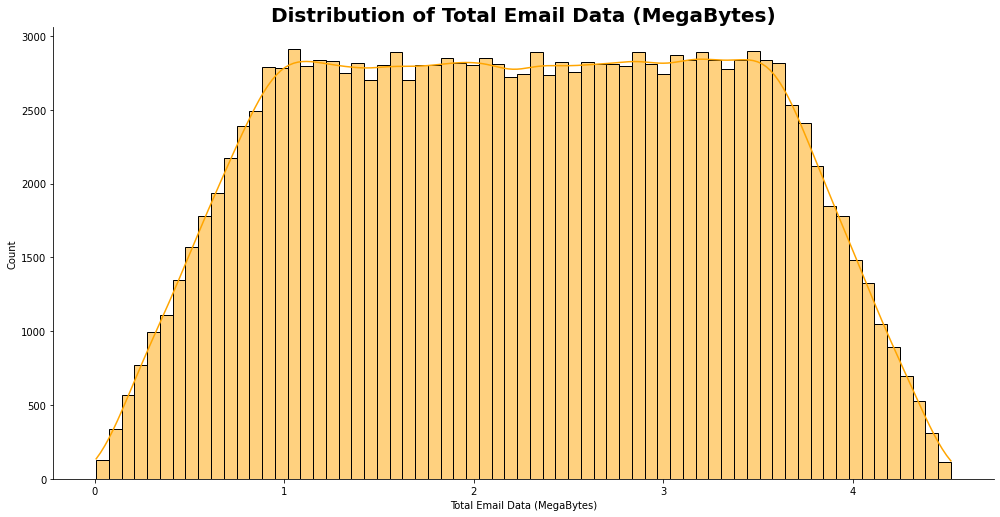

In [72]:
graph_utils.plot_hist(draw_df, 'Total Email Data (MegaBytes)', 'orange')

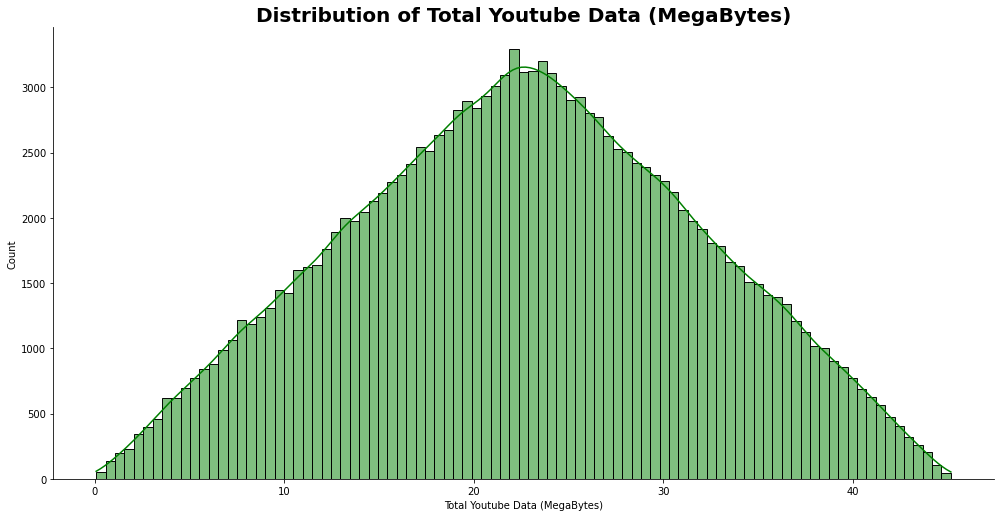

In [78]:
graph_utils.plot_hist(draw_df, 'Total Youtube Data (MegaBytes)', 'green')

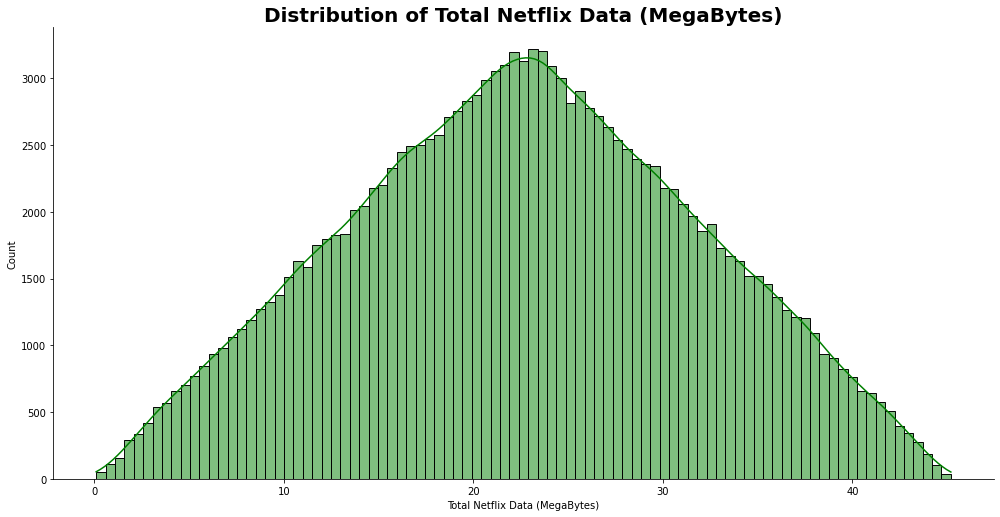

In [77]:
graph_utils.plot_hist(draw_df, 'Total Netflix Data (MegaBytes)', 'green')

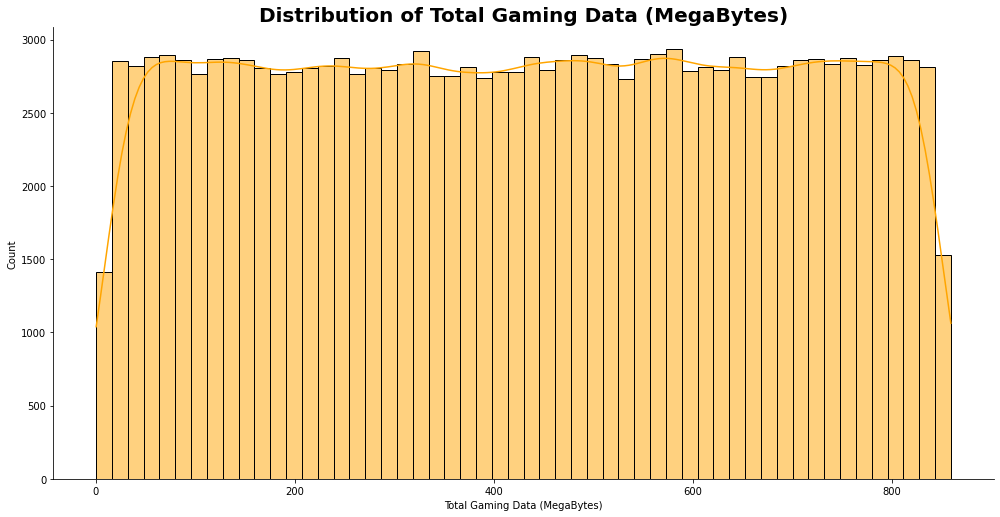

In [104]:
graph_utils.plot_hist(draw_df, 'Total Gaming Data (MegaBytes)', 'orange')

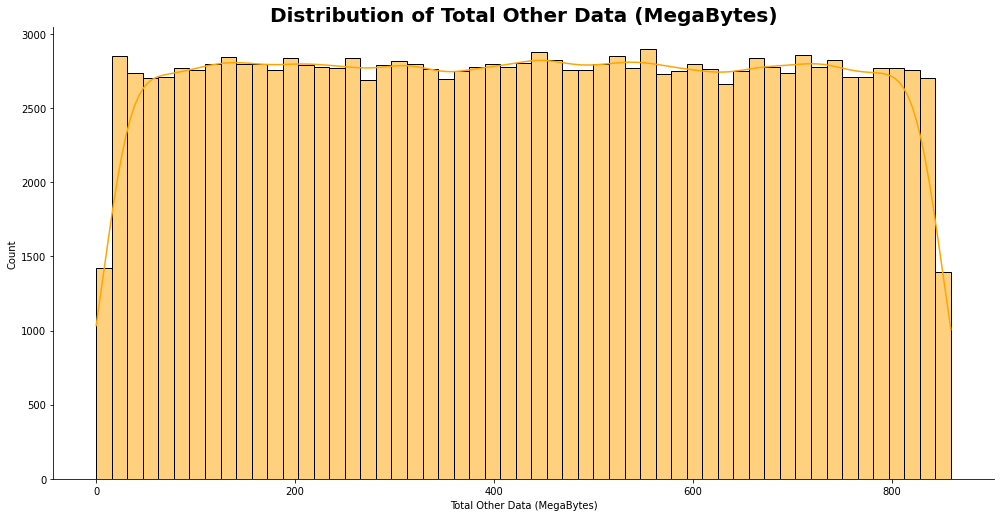

In [105]:
graph_utils.plot_hist(draw_df, 'Total Other Data (MegaBytes)', 'orange')

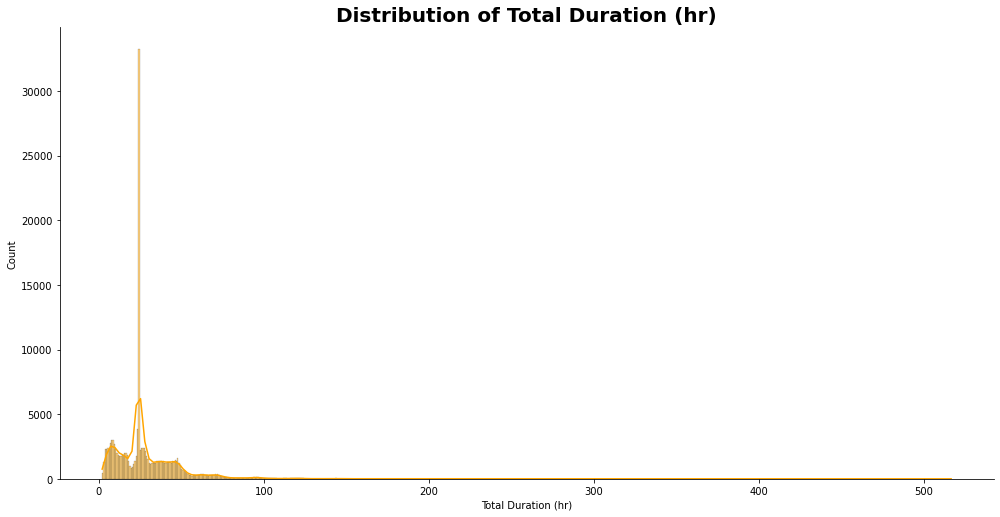

In [106]:
graph_utils.plot_hist(draw_df, "Total Duration (hr)", 'orange')

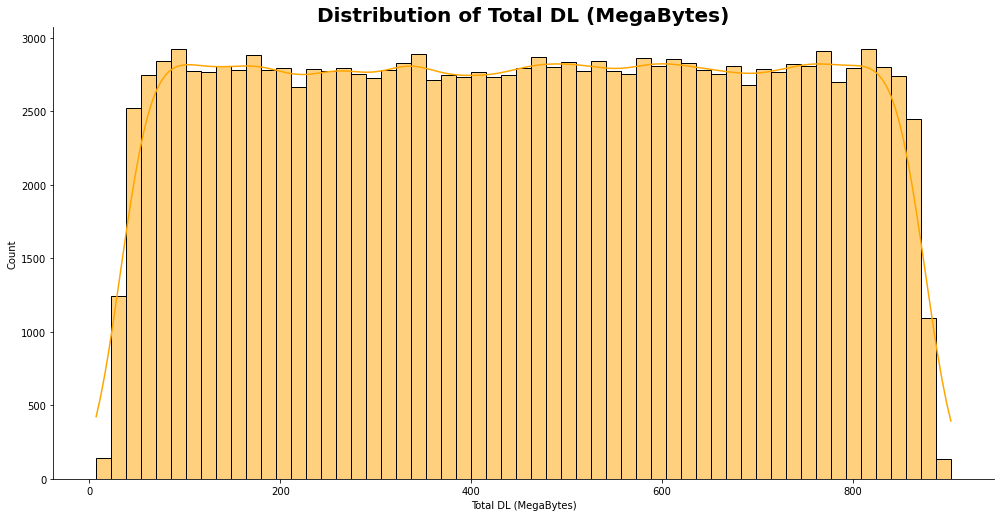

In [107]:
graph_utils.plot_hist(draw_df, "Total DL (MegaBytes)", 'orange')

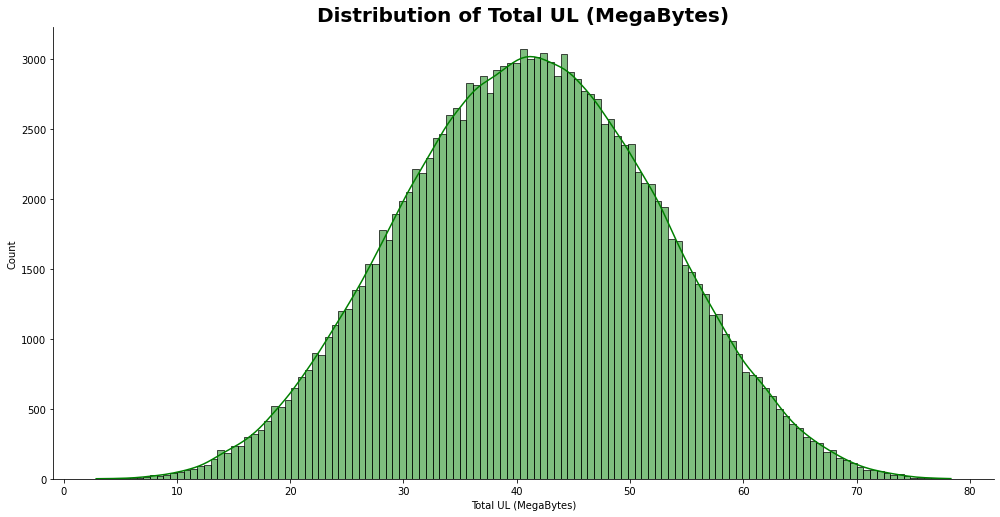

In [44]:
graph_utils.plot_hist(draw_df, "Total UL (MegaBytes)", 'green')

In [60]:
graph_utils.plot_hist(draw_df, "Total Data (MegaBytes)", 'green')

In [61]:
graph_utils.simple_plot_scatter(draw_df, x_col='Total Social Media Data (MegaBytes)', y_col='Total Data (MegaBytes)' , title="Total Social Media Data to Total Data")

In [62]:
graph_utils.simple_plot_scatter(draw_df, x_col='Total Google Data (MegaBytes)', y_col='Total Data (MegaBytes)' , title="Total Google Data to Total Data")

In [63]:
graph_utils.simple_plot_scatter(draw_df, x_col='Total Email Data (MegaBytes)', y_col='Total Data (MegaBytes)' , title="Total Email Data to Total Data")

In [64]:
graph_utils.simple_plot_scatter(draw_df, x_col='Total Youtube Data (MegaBytes)', y_col='Total Data (MegaBytes)' , title="Total Youtube Data to Total Data")

In [65]:
graph_utils.simple_plot_scatter(draw_df, x_col='Total Netflix Data (MegaBytes)', y_col='Total Data (MegaBytes)' , title="Total Netflix Data to Total Data")

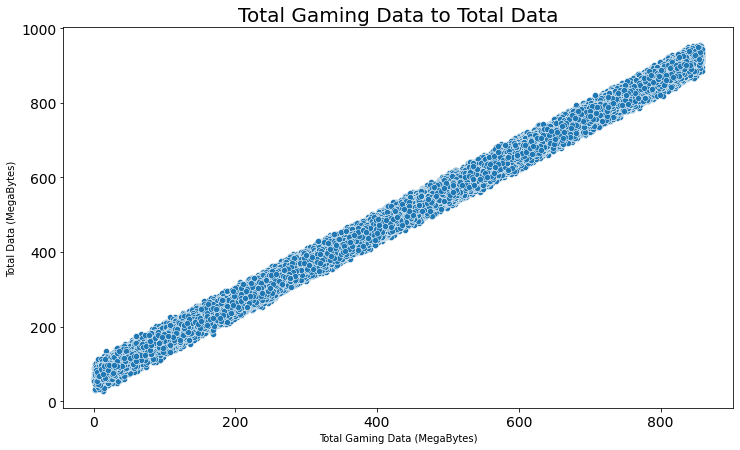

In [53]:
graph_utils.simple_plot_scatter(draw_df, x_col='Total Gaming Data (MegaBytes)', y_col='Total Data (MegaBytes)' , title="Total Gaming Data to Total Data")

In [66]:
graph_utils.simple_plot_scatter(draw_df, x_col='Total Other Data (MegaBytes)', y_col='Total Data (MegaBytes)' , title="Total Other Data to Total Data")

In [1]:
#graph_utils.plot_hist(draw_df, "Start sec", "orange")

In [ ]:
#graph_utils.plot_hist(draw_df, "Avg RTT DL (ms)", 'red')

In [2]:
#graph_utils.plot_hist(draw_df, "Avg Bearer TP DL (kbps)", 'red')

In [3]:
#graph_utils.plot_hist(draw_df, 'Activity Duration DL (sec)', 'red')

In [4]:
#graph_utils.plot_hist(draw_df, "Social Media DL (MegaBytes)", 'orange')

In [5]:
#graph_utils.plot_hist(draw_df, "Google DL (MegaBytes)", 'orange')

In [6]:
#graph_utils.plot_hist(draw_df, "Email DL (MegaBytes)", 'orange')

In [7]:
#graph_utils.plot_hist(draw_df, "Youtube DL (MegaBytes)", 'orange')

In [8]:
#graph_utils.plot_hist(draw_df, "Netflix DL (MegaBytes)", 'orange')

In [9]:
#graph_utils.plot_hist(draw_df, "Gaming DL (MegaBytes)", 'orange')

In [10]:
#graph_utils.plot_hist(draw_df, "Other DL (MegaBytes)", 'orange')

##### Outlier Diagrams

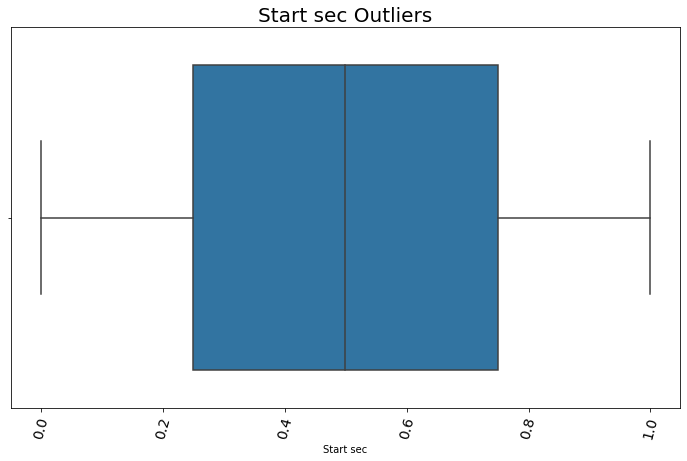

In [53]:
graph_utils.plot_box(draw_df, "Start sec", 'Start sec Outliers')

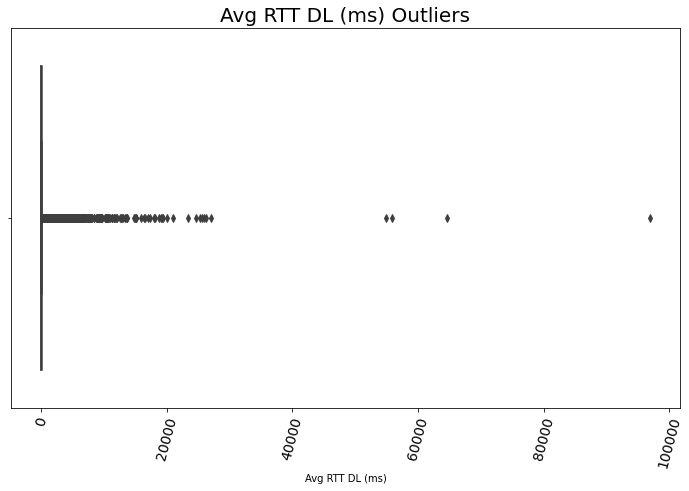

In [109]:
graph_utils.plot_box(draw_df, "Avg RTT DL (ms)", 'Avg RTT DL (ms) Outliers')

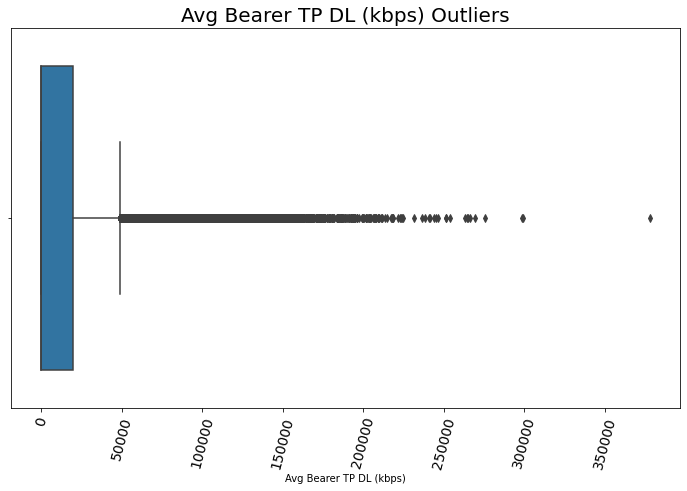

In [110]:
graph_utils.plot_box(draw_df, "Avg Bearer TP DL (kbps)", 'Avg Bearer TP DL (kbps) Outliers')

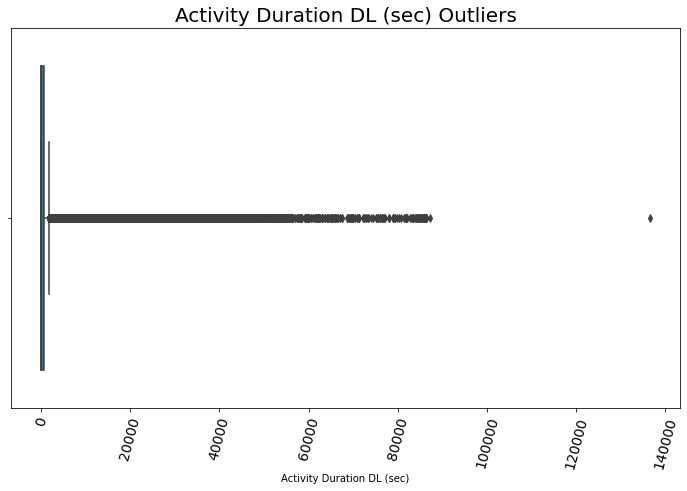

In [111]:
graph_utils.plot_box(draw_df, "Activity Duration DL (sec)", 'Activity Duration DL (sec) Outliers')

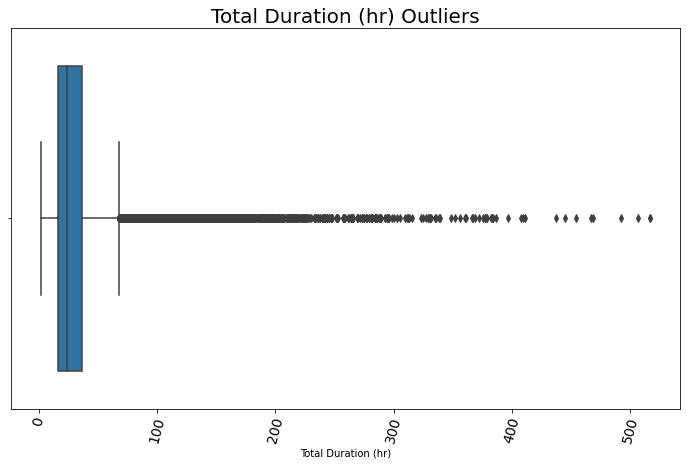

In [112]:
graph_utils.plot_box(draw_df, "Total Duration (hr)", 'Total Duration (hr) Outliers')

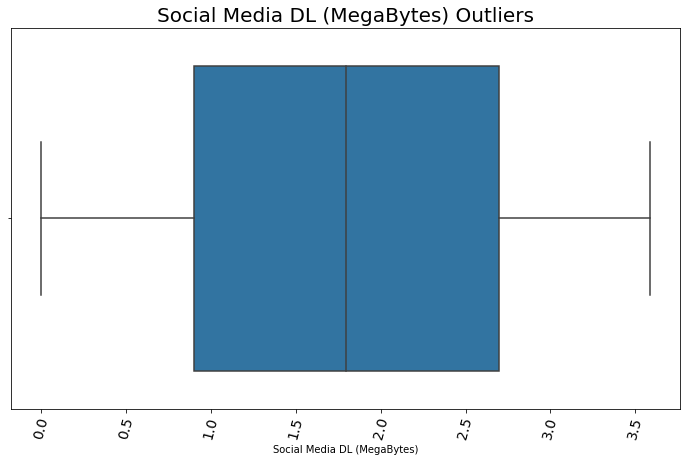

In [113]:
graph_utils.plot_box(draw_df, "Social Media DL (MegaBytes)", 'Social Media DL (MegaBytes) Outliers')

#### Bivariate Analysis

In [114]:
bivar_df = explorer.df.loc[:,['Total Data (MegaBytes)','Total Social Media Data (MegaBytes)','Total Google Data (MegaBytes)', 'Total Email Data (MegaBytes)','Total Youtube Data (MegaBytes)','Total Netflix Data (MegaBytes)','Total Gaming Data (MegaBytes)',
 'Total Other Data (MegaBytes)',]]
bivar_df

,Total Data (MegaBytes),Total Social Media Data (MegaBytes),Total Google Data (MegaBytes),Total Email Data (MegaBytes),Total Youtube Data (MegaBytes),Total Netflix Data (MegaBytes),Total Gaming Data (MegaBytes),Total Other Data (MegaBytes)
0,345.63,1.57,2.91,3.70,18.36,17.86,292.43,180.56
1,707.19,1.93,4.41,0.94,39.36,35.57,609.92,541.96
2,307.69,1.73,10.23,3.36,34.43,23.75,229.98,414.91
3,889.35,0.66,11.81,2.07,36.53,15.09,810.39,761.84
4,607.68,0.91,7.75,2.11,34.22,17.54,531.24,564.62
...,...,...,...,...,...,...,...,...
149995,872.76,0.99,1.27,4.28,24.55,29.62,797.16,336.27
149996,631.80,3.52,12.78,0.69,27.96,37.56,535.81,16.75
149997,705.78,2.35,4.42,2.12,22.17,40.64,631.63,714.64
149998,627.70,1.26,6.59,2.06,24.52,15.03,566.93,132.42


In [43]:
correlation = bivar_df.corr(method='pearson')

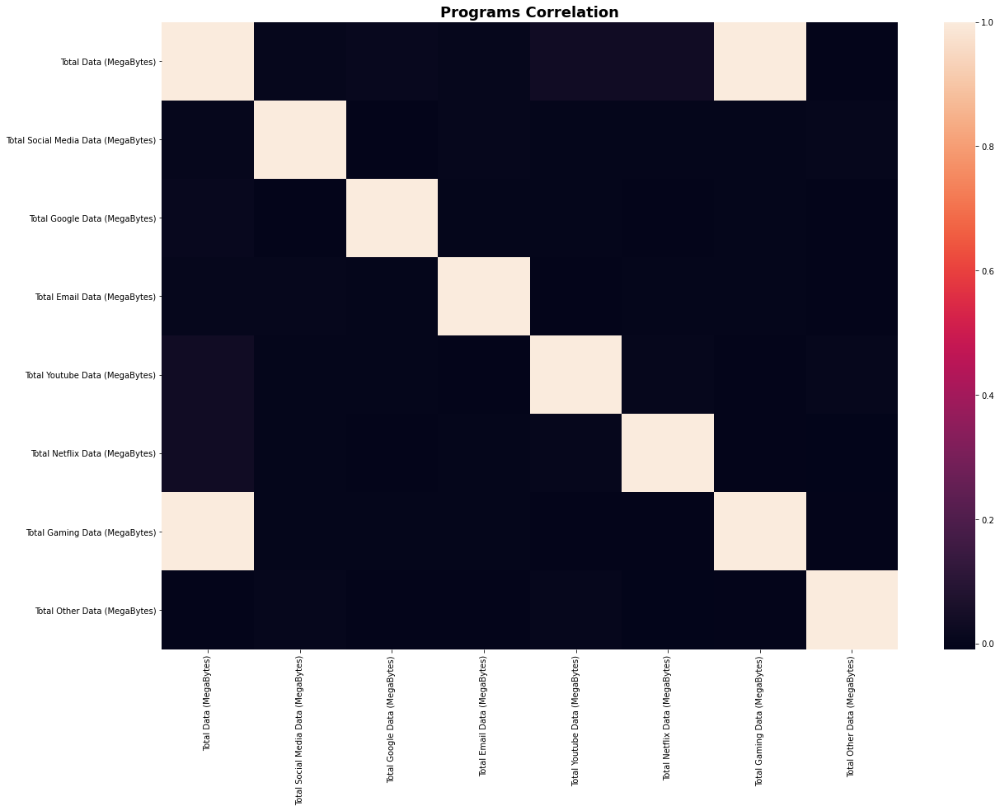

In [61]:
graph_utils.plot_heatmap_from_correlation(correlation, "Programs Correlation")

In [62]:
aggs_by_col = {'Total UL (MegaBytes)': 'sum',
               'Total DL (MegaBytes)': 'sum',
               'Social Media DL (MegaBytes)': 'sum',
               'Social Media UL (MegaBytes)': 'sum',
               'Google DL (MegaBytes)': 'sum',
               'Google UL (MegaBytes)': 'sum',
               'Email DL (MegaBytes)': 'sum',
               'Email UL (MegaBytes)': 'sum',
               'Youtube DL (MegaBytes)': 'sum',
               'Youtube UL (MegaBytes)': 'sum',
               'Netflix DL (MegaBytes)': 'sum',
               'Netflix UL (MegaBytes)': 'sum',
               'Gaming DL (MegaBytes)': 'sum',
               'Gaming UL (MegaBytes)': 'sum',
               'Other DL (MegaBytes)': 'sum',
               'Other UL (MegaBytes)': 'sum',
               'Gaming DL (MegaBytes)': 'sum',
               'Gaming UL (MegaBytes)': 'sum',
               'Total Data (MegaBytes)': 'sum'
               }

user_grouped_bivar_df = explorer.df.groupby('MSISDN/Number').agg(aggs_by_col)

start_date_grouped_bivar_df = explorer.df.groupby('start_date').agg(aggs_by_col)

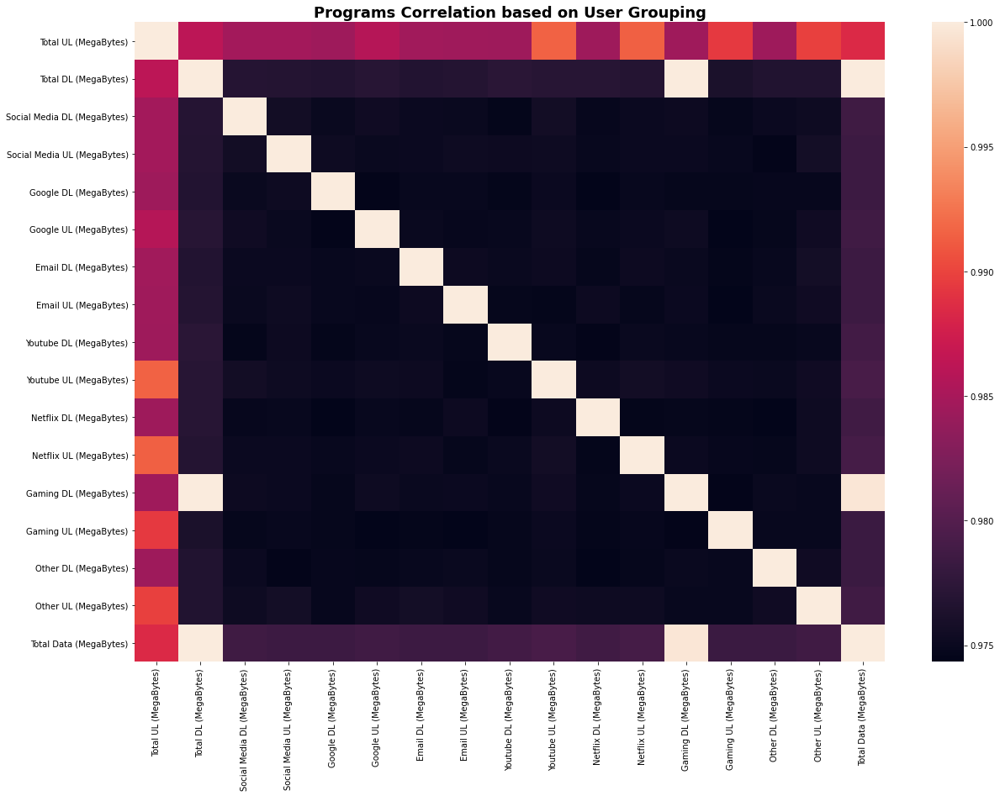

In [63]:
user_grouped_corr = user_grouped_bivar_df.corr(method='pearson')
graph_utils.plot_heatmap_from_correlation(user_grouped_corr, "Programs Correlation based on User Grouping")

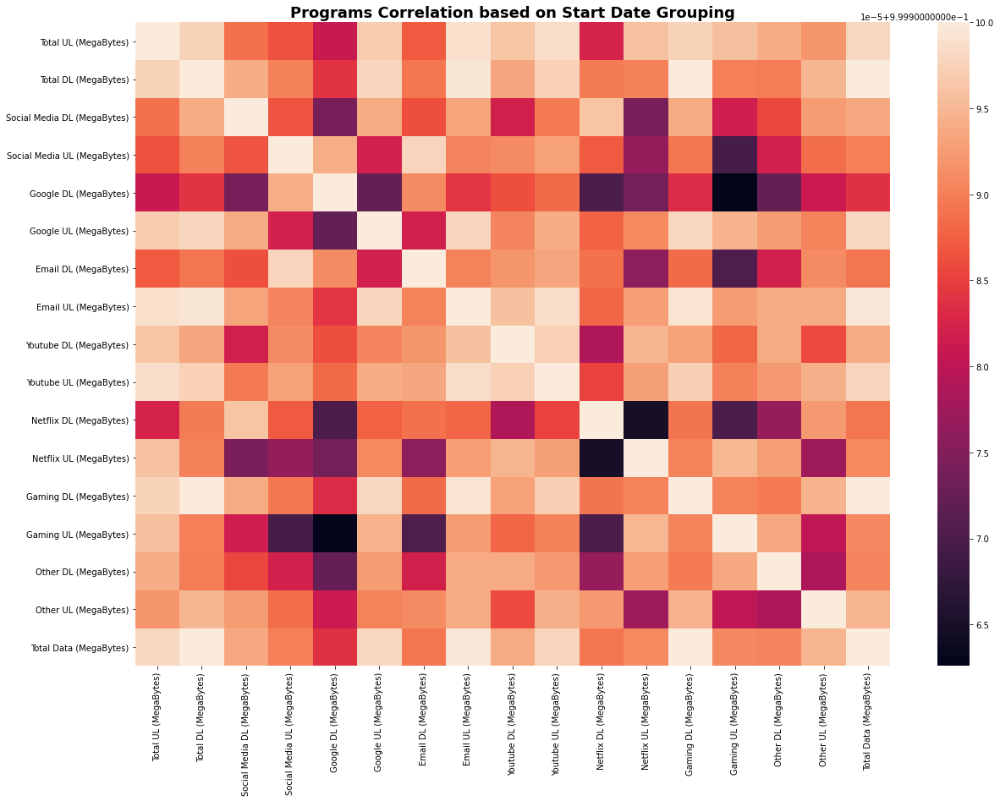

In [64]:
start_date_grouped_corr = start_date_grouped_bivar_df.corr(method='pearson')
graph_utils.plot_heatmap_from_correlation(start_date_grouped_corr, "Programs Correlation based on Start Date Grouping")

#### Variable transformations

In [42]:
explorer.create_decile('Total Duration (hr)')
explorer.create_quantile('Total Duration (hr)')


In [66]:
trans_df = explorer.df.loc[:,['decile','Total UL (MegaBytes)','Total DL (MegaBytes)']]
trans_df = trans_df.groupby('decile')['Total UL (MegaBytes)','Total DL (MegaBytes)'].sum()
trans_df = trans_df[trans_df.index >= 5]
trans_df['Total UL + DL (MegaBytes)'] = trans_df['Total UL (MegaBytes)'] + trans_df['Total DL (MegaBytes)']
trans_df

<ipython-input-66-ffaa829d830b>:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  trans_df = trans_df.groupby('decile')['Total UL (MegaBytes)','Total DL (MegaBytes)'].sum()


,Total UL (MegaBytes),Total DL (MegaBytes),Total UL + DL (MegaBytes)
decile,,,
5,578706.00,6357860.50,6936566.50
4,616788.94,6821214.50,7438003.50
3,615797.06,6801132.50,7416929.50
2,615919.38,6842822.50,7458742.00
1,616275.12,6843324.50,7459599.50


#### Correlation Analysis

In [41]:
corr_UL_df = explorer.df.loc[:,['Social Media UL (MegaBytes)','Google UL (MegaBytes)', 'Email UL (MegaBytes)', 'Youtube UL (MegaBytes)', 'Netflix UL (MegaBytes)', 'Gaming UL (MegaBytes)', 'Other UL (MegaBytes)']]
# corr_UL_df.corr(method='pearson')

In [39]:
corr_DL_df = explorer.df.loc[:,['Social Media DL (MegaBytes)','Google DL (MegaBytes)', 'Email DL (MegaBytes)', 'Youtube DL (MegaBytes)', 'Netflix DL (MegaBytes)', 'Gaming DL (MegaBytes)', 'Other DL (MegaBytes)']]
#corr_DL_df.corr(method='pearson')

In [40]:
corr_UL_DL_df = explorer.df.loc[:,['Social Media UL (MegaBytes)','Google UL (MegaBytes)', 'Email UL (MegaBytes)', 'Youtube UL (MegaBytes)', 'Netflix UL (MegaBytes)', 'Gaming UL (MegaBytes)', 'Other UL (MegaBytes)','Social Media DL (MegaBytes)','Google DL (MegaBytes)', 'Email DL (MegaBytes)', 'Youtube DL (MegaBytes)', 'Netflix DL (MegaBytes)', 'Gaming DL (MegaBytes)', 'Other DL (MegaBytes)']]
#corr_UL_DL_df.corr(method='pearson')

#### Dimensionality Reduction

In [72]:
import numpy as np
dim_reduce_df  = explorer.df.loc[:,['Social Media UL (MegaBytes)','Google UL (MegaBytes)', 'Email UL (MegaBytes)', 'Youtube UL (MegaBytes)', 'Netflix UL (MegaBytes)', 'Gaming UL (MegaBytes)', 'Other UL (MegaBytes)','Social Media DL (MegaBytes)','Google DL (MegaBytes)', 'Email DL (MegaBytes)', 'Youtube DL (MegaBytes)', 'Netflix DL (MegaBytes)', 'Gaming DL (MegaBytes)', 'Other DL (MegaBytes)', 'Total Duration (hr)']]

len(dim_reduce_df.columns.to_list()) ## 15
pca = PCA(n_components=4)
pca.fit(dim_reduce_df)
pca.transform(dim_reduce_df)


print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))

Explained variation per principal component: [4.98929623e-01 4.94890967e-01 4.24363934e-03 3.78894751e-04]
